In [3]:
from poseidon.signal.passivesonar import demon
from poseidon.io.offline import load_raw_data

from pathlib import Path
import os

import seaborn as sns

import numpy as np
import pandas as pd
from scipy.signal import decimate
import matplotlib.pyplot as plt
from matplotlib.ticker import (MultipleLocator, AutoMinorLocator)

## Load config

In [4]:
home = Path(os.environ['HOME'])

raw_datapath = home / 'Workspace' / 'lps' / '4classes'
plotdir = Path('.') / 'plots'


## Load data

In [5]:
db = load_raw_data(raw_datapath)

## Bandpass filter design

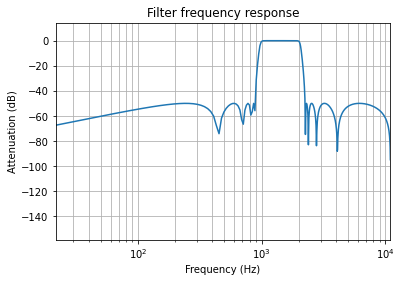

In [6]:
from scipy import signal
fs = 22050
nyq = 0.5*fs
wp = [1000/nyq, 2000/nyq]
ws = [700/nyq, 2300/nyq]
Ap = 0.5
As = 50
N, wc = signal.cheb2ord(wp, ws, Ap, As)

b, a = signal.cheby2(N, As, wc, 'bandpass')
w, h = signal.freqz(b, a)
plt.semilogx(w*fs/(2*np.pi) , 20 * np.log10(abs(h)))
plt.title('Filter frequency response')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Attenuation (dB)')
plt.margins(0, 0.1)
plt.grid(which='both', axis='both')
plt.show()
plt.close()

## DEMON analysis

In [7]:
type = 'ClassA'
file = 'navio10'

run,fs = db[type][file]['signal'], db[type][file]['fs']

sxx, freq, time = demon(run, fs, max_freq=35, apply_bandpass=True)

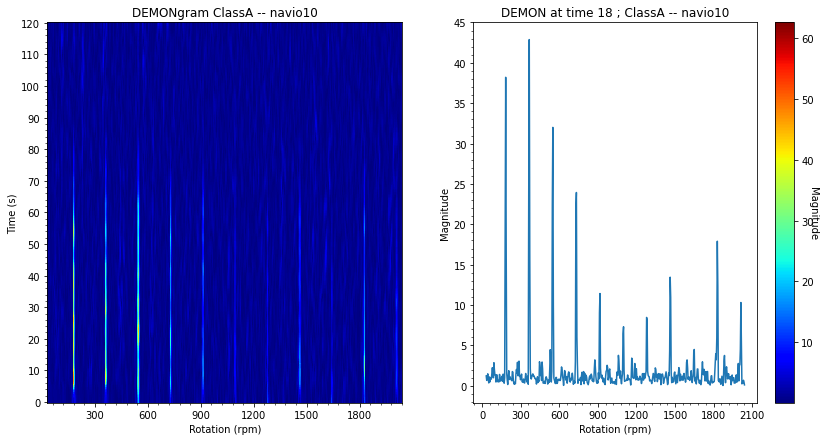

In [8]:
def plot_spectrogram(pfreq, ptime, psxx, show_rpm=True, show=True, savepath=None):
    freq, time, sxx = pfreq.copy(), ptime.copy(), psxx.copy()

    fig,axes = plt.subplots(ncols=2, figsize=(14,7))

    if show_rpm:
        freq *= 60
        xlabel = "Rotation (rpm)"
        tick_multiplier = 60
    else:
        xlabel = "Frequency (Hz)"
        tick_multiplier = 1

    cmap = axes[0].pcolormesh(freq, time, sxx, cmap='jet', vmin=np.quantile(sxx, 0.00), shading='auto',vmax=sxx.max());
    idx_freq = np.arange(0, freq.shape[0], dtype=int)
    idx_time = np.arange(0, time.shape[0], dtype=int)

    x_n_ticks = 6
    hop = idx_freq.shape[0]//x_n_ticks
    time_pos = 36

    axes[1].plot(freq, sxx[time_pos, :])

    axes[0].set_title("DEMONgram %s -- %s" % (type, file))
    axes[1].set_title("DEMON at time %i ; %s -- %s" % (time[time_pos], type, file))

    axes[0].set_xlabel(xlabel)
    axes[1].set_xlabel(xlabel)

    axes[0].set_ylabel("Time (s)")
    axes[1].set_ylabel("Magnitude")

    for ax in axes:
        ax.xaxis.set_major_locator(MultipleLocator(5*tick_multiplier))
        ax.xaxis.set_minor_locator(MultipleLocator(1*tick_multiplier))
    
    axes[0].yaxis.set_major_locator(MultipleLocator(10))
    axes[0].yaxis.set_minor_locator(MultipleLocator(2))

    axes[1].yaxis.set_major_locator(MultipleLocator(5))
    axes[1].yaxis.set_minor_locator(MultipleLocator(1))

    cbar = plt.colorbar(cmap)
    cbar.ax.set_ylabel('Magnitude', rotation=270)

    if show:
        plt.show()

    if savepath is not None:
        fig.savefig(savepath)

    plt.close()

plot_spectrogram(freq, time, sxx)

## Plot all runs and save

In [9]:
def demon_run(run_rec, type, file, max_freq=35, apply_bandpass=True, savedir='./'):
    run,fs = db[type][file]['signal'], db[type][file]['fs']

    savepath = Path(savedir) / type
    savepath.mkdir(parents=True, exist_ok=True)

    sxx, freq, time = demon(run, fs, max_freq=max_freq, apply_bandpass=apply_bandpass)
    plot_spectrogram(freq, time, sxx, show_rpm=True, show=False, savepath=savepath / file)

for type, runs in db.items():
    for ship, run in runs.items():
        demon_run(run, type, ship, savedir=plotdir)